# SETUP SYNTH ENGINE

In [15]:
from scipy.io import wavfile
import dawdreamer as daw
import numpy as np
import os
SAMPLE_RATE = 44100

BUFFER_SIZE = 128 # Parameters will undergo automation at this buffer/block size.
PPQN = 960 # Pulses per quarter note.
SYNTH_PLUGIN = os.path.expanduser('~')+"/../../Library/Audio/Plug-Ins/VST/TAL-NoiseMaker.vst"#os.path.expanduser('~')+"/../../Library/Audio/Plug-Ins/Components/TAL-NoiseMaker.component"  # extensions: .dll, .vst3, .vst, .component
# REVERB_PLUGIN = "C:/path/to/reverb.dll"  # extensions: .dll, .vst3, .vst, .component
# MIDI_PATH = "../resources/MIDI/song.mid"

engine = daw.RenderEngine(SAMPLE_RATE, BUFFER_SIZE)

# Make a processor and give it the unique name "my_synth", which we use later.
synth = engine.make_plugin_processor("my_synth", SYNTH_PLUGIN)
synth.load_state('../resources/plugins/params/save_states/BasePad')


error: attempt to map invalid URI `/Users/vedant/../../Library/Audio/Plug-Ins/VST/TAL-NoiseMaker.vst'
Attempting to load VST: /Library/Audio/Plug-Ins/VST/TAL-NoiseMaker.vst
Creating VST instance: TAL-NoiseMaker
Initialising VST: TAL-NoiseMaker (5.0.4.0)
Attempting to load VST: /Library/Audio/Plug-Ins/VST/TAL-NoiseMaker.vst
Creating VST instance: TAL-NoiseMaker
Initialising VST: TAL-NoiseMaker (5.0.4.0)


# ADDITIONAL PROCESSING (Not part of pipeline)

In [10]:
import pandas as pd
# master_parameters = pd.DataFrame()
# param_name=[]
# param_number = []
# preset_names=[]
# param_value=[]

# for preset_name in os.listdir('../resources/plugins/params/save_states'):
#     synth.load_state('../resources/plugins/params/save_states/'+preset_name)
#     for i in range(len(synth.get_parameters_description())):
#         param_name.append(synth.get_parameter_name(i).lower().replace(' ','_'))
#         param_number.append(i)
#         preset_names.append(preset_name)
#         param_value.append(synth.get_parameter(i))

# master_parameters['parameter_name'] = param_name
# master_parameters['parameter_number'] = param_number
# master_parameters['preset_name'] = preset_names
# master_parameters['parameter_value'] = param_value

# master_parameters['mean'] = master_parameters['parameter_value']
# master_parameters['std'] = master_parameters['parameter_value']/10

master_parameters = pd.read_csv('../resources/working_data/preset_parameter_mapping.csv', header=0)

# CREATE MIDI NOTES/CHORD MAPPING

In [ ]:
# TODO: Create a mapping between emotion and notes and chords, to be sampled for triggering the synth


# Sampling parameter values for synth timbre

In [16]:
ignored_params = ['-','master_volume','midi_clear', 'midi_lock']

# TODO: create logic mapping presets to emotions
synth_timbre = 'BasePad' # possible values are ['TwoFlower','Bellomatism','GatedPad','FloatingPad','FantasyPad','FuzzyChorda','BigTrancer','LuxuryStrings','BitOrchestra','DarkAnimations','SunRise','DreamOf86','ParallaxPad','PadWobbler','SweetAnalogue','RingmodMod','BurstingPad','Tron','BionicPad','Lightstorm','OpenSquare','Ringmodded','Glasometer','Easymat','BasePad','SpookyOrgan']

target_preset = master_parameters[master_parameters['preset_name'] == synth_timbre]

# Sampling values from a normal distribution
target_preset['value'] = np.random.normal(target_preset['mean'], target_preset['std'])

# Filtering relevant parameters (zero value params retained)
target_values = {}
for i in range(len(target_preset)):
    if target_preset.iloc[i]['parameter_name'] not in ignored_params:
        target_values[target_preset.iloc[i]['parameter_number']] = target_preset.iloc[i]['value']
        
# Loading the preset closest to the required parameters
synth.load_state(f'../resources/plugins/params/save_states/{synth_timbre}')

# Setting parameters sampled from distribution
for param_num in target_values.keys():
    synth.set_parameter(param_num, target_values[param_num])

/var/folders/hs/h9zhlkvj4b9d3mmzwzsd87vr0000gn/T/ipykernel_9838/4138704934.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target_preset['value'] = np.random.normal(target_preset['mean'], target_preset['std'])


# RENDERING AUDIO

In [17]:
synth.add_midi_note(60, 127, 0.5, .25) # (MIDI note, velocity, start, duration)


engine.load_graph([(synth, [])])
engine.render(5)
output = engine.get_audio()
wavfile.write(f'output.wav', SAMPLE_RATE, output.transpose())

# USING TORCHSYNTH

In [18]:
!pip install torchsynth

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 706.6/706.6 kB 4.9 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.8/133.8 MB 13.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 24.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 197.6/197.6 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 419.6/419.6 kB 9.4 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.8/140.8 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 575.3/575.3 kB 12.6 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.7/232.7 kB 7.8 MB/s eta 0:00:00
  Using cached google_auth_oauthlib-0.4.6-py2.py3-none-any.whl (18 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.2/167.2 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.4/123.4 kB 4.3 MB/s eta 0:00:00
 

In [25]:
import numpy as np
import librosa
import random
import numpy.random
import torch
from torch import tensor
import matplotlib.pyplot as plt

from torchsynth.config import SynthConfig
from torchsynth.module import (
    ADSR,
    VCA,
    ControlRateUpsample,
    MonophonicKeyboard,
    Noise,
    SineVCO,
    FmVCO,
)
from torchsynth.parameter import ModuleParameterRange

# Determenistic seeds for replicable testing
random.seed(0)
numpy.random.seed(0)
torch.manual_seed(0)

In [26]:
# Run examples on GPU if available
if torch.cuda.is_available():
    device = "cuda"
else:
    device = "cpu"

In [27]:
def iscolab():  # pragma: no cover
    return "google.colab" in str(get_ipython())

def isnotebook():  # pragma: no cover
    try:
        if iscolab():
            return True
        shell = get_ipython().__class__.__name__
        if shell == "ZMQInteractiveShell":
            return True  # Jupyter notebook or qtconsole
        elif shell == "TerminalInteractiveShell":
            return False  # Terminal running IPython
        else:
            return False  # Other type (?)
    except NameError:
        return False  # Probably standard Python interprete

def time_plot(signal, sample_rate=44100, show=True):
    if isnotebook():  # pragma: no cover
        t = np.linspace(0, len(signal) / sample_rate, len(signal), endpoint=False)
        plt.plot(t, signal)
        plt.xlabel("Time")
        plt.ylabel("Amplitude")
        if show:
            plt.show()

def stft_plot(signal, sample_rate=44100):
    if isnotebook():  # pragma: no cover
        X = librosa.stft(signal)
        Xdb = librosa.amplitude_to_db(abs(X))
        plt.figure(figsize=(5, 5))
        librosa.display.specshow(Xdb, sr=sample_rate, x_axis="time", y_axis="log")
        plt.show()

if isnotebook():  # pragma: no cover
    import IPython.display as ipd
    import librosa
    import librosa.display
    import matplotlib.pyplot as plt
    from IPython.core.display import display
else:

    class IPD:
        def Audio(*args, **kwargs):
            pass

        def display(*args, **kwargs):
            pass

    ipd = IPD()

/var/folders/hs/h9zhlkvj4b9d3mmzwzsd87vr0000gn/T/ipykernel_9838/3878654833.py:40: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display


In [29]:
synthconfig = SynthConfig(
    batch_size=2, reproducible=False, sample_rate=44100, buffer_size_seconds=4.0
)

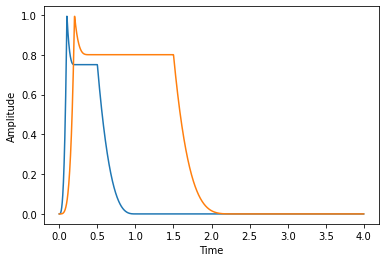

ADSR(a=ModuleParameter(name=attack, value=tensor([0.2236, 0.3162])), d=ModuleParameter(name=decay, value=tensor([0.2236, 0.3162])), s=ModuleParameter(name=sustain, value=tensor([0.7500, 0.8000])), r=ModuleParameter(name=release, value=tensor([0.3162, 0.4000])), alpha=ModuleParameter(name=alpha, value=tensor([0.4915, 0.6610]))


In [30]:
# Synthesis parameters.
a = tensor([0.1, 0.2])
d = tensor([0.1, 0.2])
s = tensor([0.75, 0.8])
r = tensor([0.5, 0.8])
alpha = tensor([3.0, 4.0])
note_on_duration = tensor([0.5, 1.5], device=device)

# Envelope test
adsr = ADSR(
    attack=a,
    decay=d,
    sustain=s,
    release=r,
    alpha=alpha,
    synthconfig=synthconfig,
    device=device,
)


envelope = adsr(note_on_duration)
time_plot(envelope.clone().detach().cpu().T, adsr.control_rate.item())
print(adsr)

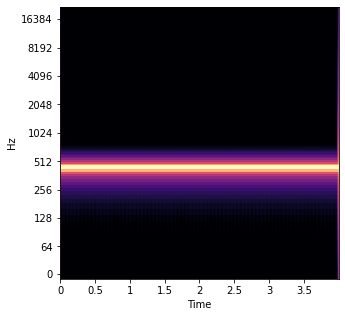

In [35]:
# Set up a Keyboard module
keyboard = MonophonicKeyboard(
    synthconfig, device, midi_f0=tensor([69.0, 50.0]), duration=note_on_duration
)

# Trigger the keyboard, which returns a midi_f0 and note duration
midi_f0, duration = keyboard()

# Instantiate the sine wave VCO with tuning set to zero
sine_vco = SineVCO(
    tuning=tensor([0.0, 0.0]),
    synthconfig=synthconfig,
).to(device)

# Call the sine_vco with the midi_f0
sine_out = sine_vco(midi_f0)

stft_plot(sine_out[0].detach().cpu().numpy())
ipd.display(ipd.Audio(sine_out[0].detach().cpu().numpy(), rate=sine_vco.sample_rate.item()))

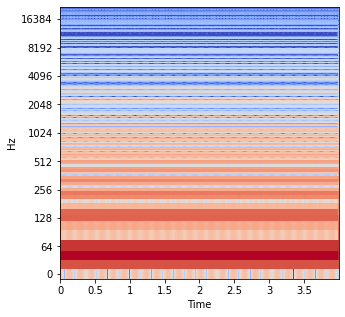

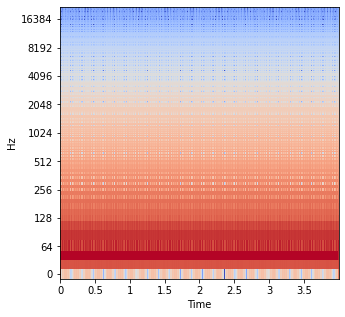

Signal(0.8532, grad_fn=<AliasBackward0>)


In [36]:
from torchsynth.module import SquareSawVCO

keyboard = MonophonicKeyboard(synthconfig, device, midi_f0=tensor([30.0, 30.0])).to(
    device
)

square_saw = SquareSawVCO(
    tuning=tensor([0.0, 0.0]),
    mod_depth=tensor([0.0, 0.0]),
    shape=tensor([0.0, 1.0]),
    synthconfig=synthconfig,
    device=device,
)
env2 = torch.zeros([2, square_saw.buffer_size], device=device)

square_saw_out = square_saw(keyboard.p("midi_f0"), env2)
stft_plot(square_saw_out[0].cpu().detach().numpy())
ipd.display(
    ipd.Audio(
        square_saw_out[0].cpu().detach().numpy(), rate=square_saw.sample_rate.item()
    )
)
stft_plot(square_saw_out[1].cpu().detach().numpy())
ipd.display(
    ipd.Audio(
        square_saw_out[1].cpu().detach().numpy(), rate=square_saw.sample_rate.item()
    )
)


err = torch.mean(torch.abs(square_saw_out[0] - square_saw_out[1]))
print(err)
# err.backward(retain_graph=True)
# for p in square_saw.torchparameters:
#    print(f"{p} grad1={square_saw.torchparameters[p][0].grad.item()} grad2={square_saw.torchparameters[p][1].grad.item()}")

# ### VCA
#
# Notice that this sound is rather clicky. We'll add an envelope to the
# amplitude to smooth it out.


In [41]:
envelope.shape

torch.Size([2, 1764])

In [42]:
square_saw_out.shape

torch.Size([2, 176400])

In [40]:
vca = VCA(synthconfig, device=device)
test_output = vca(envelope, square_saw_out)

time_plot(test_output[0].detach().cpu())
# FmVCO test

keyboard = MonophonicKeyboard(
    synthconfig, device=device, midi_f0=tensor([50.0, 50.0])
).to(device)

# Make steady-pitched sine (no pitch modulation).
sine_operator = SineVCO(
    tuning=tensor([0.0, 0.0]),
    mod_depth=tensor([0.0, 5.0]),
    synthconfig=synthconfig,
    device=device,
)
operator_out = sine_operator(keyboard.p("midi_f0"), envelope)

# Shape the modulation depth.
operator_out = vca(envelope, operator_out)

# Feed into FM oscillator as modulator signal.
fm_vco = FmVCO(
    tuning=tensor([0.0, 0.0]),
    mod_depth=tensor([2.0, 5.0]),
    synthconfig=synthconfig,
    device=device,
)
fm_out = fm_vco(keyboard.p("midi_f0"), operator_out)

stft_plot(fm_out[0].cpu().detach().numpy())
ipd.display(ipd.Audio(fm_out[0].cpu().detach().numpy(), rate=fm_vco.sample_rate.item()))

stft_plot(fm_out[1].cpu().detach().numpy())
ipd.display(ipd.Audio(fm_out[1].cpu().detach().numpy(), rate=fm_vco.sample_rate.item()))

RuntimeError: The size of tensor a (1764) must match the size of tensor b (176400) at non-singleton dimension 1

In [43]:
from torchsynth.module import AudioMixer

env = torch.zeros((synthconfig.batch_size, synthconfig.buffer_size), device=device)

keyboard = MonophonicKeyboard(synthconfig, device=device)
sine = SineVCO(synthconfig, device=device)
square_saw = SquareSawVCO(synthconfig, device=device)
noise = Noise(synthconfig, seed=123, device=device)

midi_f0, note_on_duration = keyboard()
sine_out = sine(midi_f0, env)
sqr_out = square_saw(midi_f0, env)
noise_out = noise()

mixer = AudioMixer(synthconfig, 3, curves=[1.0, 1.0, 0.25]).to(device)
output = mixer(sine_out, sqr_out, noise_out)

ipd.Audio(output[0].cpu().detach().numpy(), rate=mixer.sample_rate.item(), normalize=False)

In [75]:
midi_f0

tensor([98.3597, 55.4852], grad_fn=<AddBackward0>)

In [46]:
from torchsynth.synth import Voice

synthconfig1 = SynthConfig(
    batch_size=1, reproducible=False, sample_rate=44100, buffer_size_seconds=4.0
)

voice1 = Voice(synthconfig=synthconfig1).to(device)
voice1.set_parameters(
    {
        ("keyboard", "midi_f0"): tensor([69.0]),
        ("keyboard", "duration"): tensor([1.0]),
        ("vco_1", "tuning"): tensor([0.0]),
        ("vco_1", "mod_depth"): tensor([12.0]),
    }
)

/Users/vedant/miniconda3/envs/bgm-generation/lib/python3.10/site-packages/pytorch_lightning/core/lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


Audio output: 
Signal([[1.2892e-08, 1.8751e-04, 2.9753e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]])

Parameters used to create audio: 
tensor([[0.5433, 0.4981, 0.8615, 0.0865, 0.5069, 0.4150, 0.2367, 0.5661, 0.9135,
         0.3538, 0.2032, 0.3151, 0.0044, 0.7257, 0.2599, 0.1663, 0.2119, 0.7875,
         0.7648, 0.8838, 0.6814, 0.3330, 0.3603, 0.6477, 0.9110, 0.6359, 0.2634,
         0.2650, 0.0273, 0.6080, 0.2194, 0.0542, 0.9384, 0.1753, 0.4431, 0.6432,
         0.5159, 0.1636, 0.0958, 0.8985, 0.5814, 0.9148, 0.3324, 0.6473, 0.3857,
         0.4778, 0.1955, 0.6691, 0.6581, 0.4897, 0.3875, 0.1918, 0.8458, 0.1278,
         0.7048, 0.3319, 0.2588, 0.5898, 0.2403, 0.6152, 0.5982, 0.1288, 0.5832,
         0.7130, 0.6979, 0.4371, 0.0901, 0.4229, 0.5000, 0.8299, 0.6898, 0.8330,
         0.2389, 0.5049, 0.7067, 0.5392, 0.5418, 0.5624]])

Is test: 
None



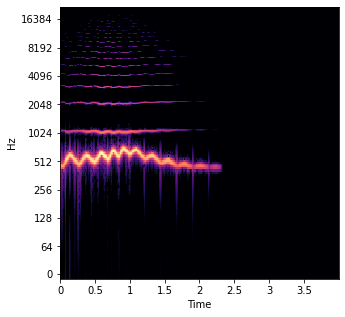

In [47]:
audio_out, parameters, is_train = voice1()
print(f"Audio output: \n{audio_out}\n")
print(f"Parameters used to create audio: \n{parameters}\n")
print(f"Is test: \n{is_train}\n")

stft_plot(audio_out.cpu().view(-1).detach().numpy())
ipd.Audio(audio_out.cpu().detach().numpy(), rate=voice1.sample_rate.item())

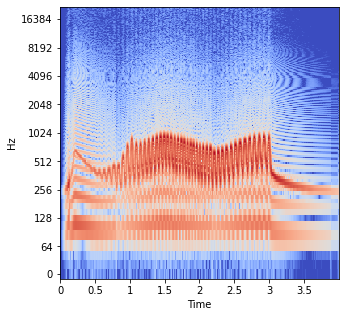

In [48]:
voice2 = Voice(synthconfig=synthconfig1).to(device)
voice2.set_parameters(
    {
        ("keyboard", "midi_f0"): tensor([40.0]),
        ("keyboard", "duration"): tensor([3.0]),
        ("vco_1", "tuning"): tensor([19.0]),
        ("vco_1", "mod_depth"): tensor([24.0]),
        ("vco_2", "tuning"): tensor([0.0]),
        ("vco_2", "mod_depth"): tensor([12.0]),
        ("vco_2", "shape"): tensor([1.0]),
    }
)

# Only grab the audio output from this voice
voice_out2, _, _ = voice2()
stft_plot(voice_out2.cpu().view(-1).detach().numpy())
ipd.Audio(voice_out2.cpu().detach().numpy(), rate=voice2.sample_rate.item())

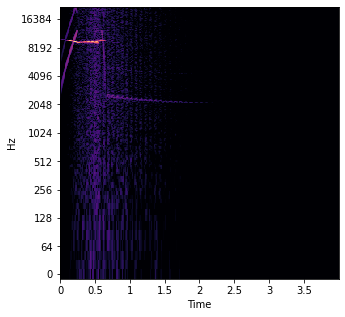

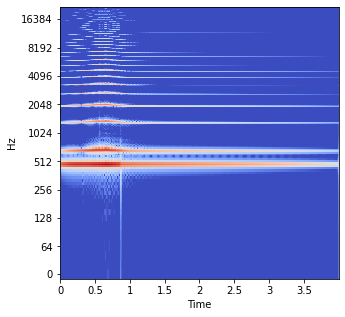

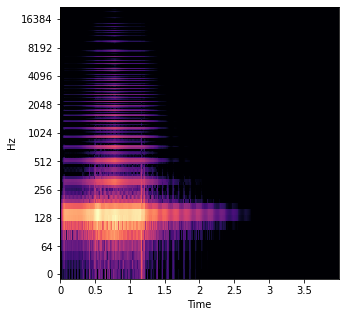

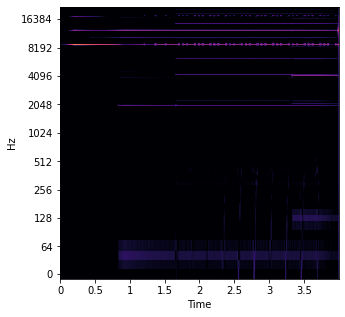

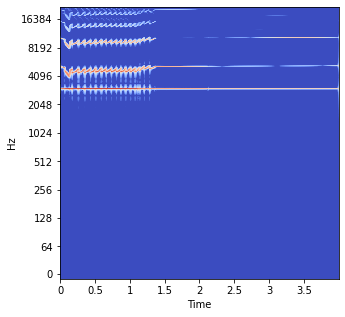

...

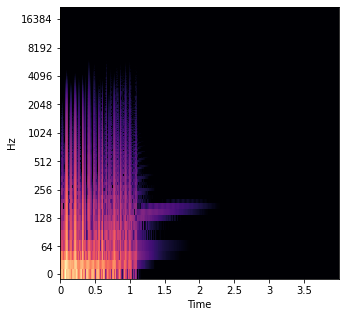

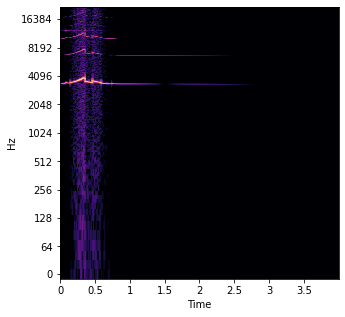

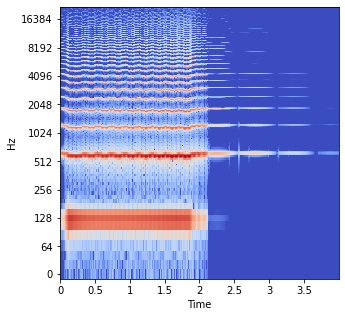

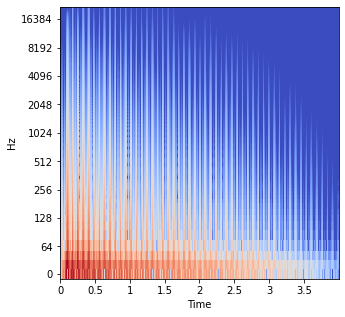

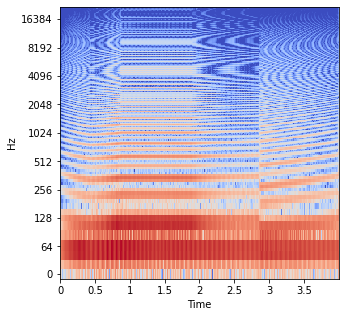

In [49]:
synthconfig16 = SynthConfig(
    batch_size=16, reproducible=False, sample_rate=44100, buffer_size_seconds=4
)
voice = Voice(synthconfig=synthconfig16).to(device)
voice_out, _, _ = voice()
for i in range(synthconfig16.batch_size):
    stft_plot(voice_out[i].cpu().view(-1).detach().numpy())
    ipd.display(
        ipd.Audio(voice_out[i].cpu().detach().numpy(), rate=voice.sample_rate.item())
    )

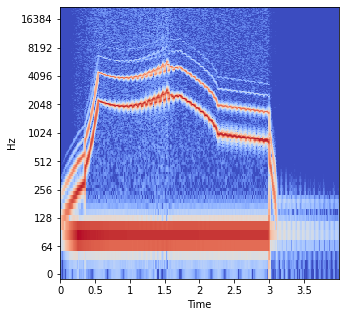

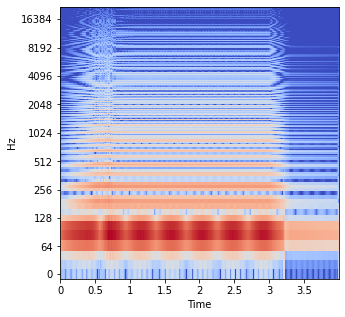

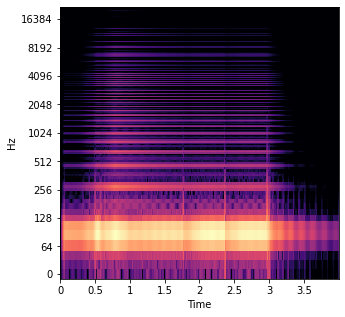

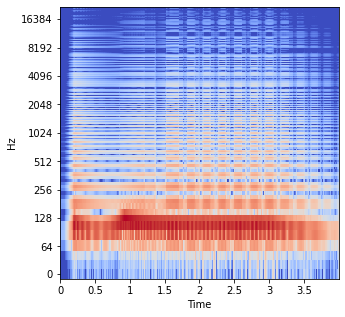

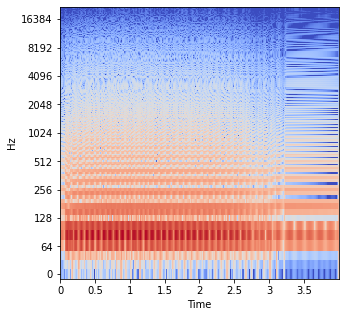

...

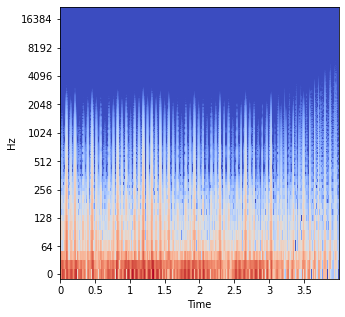

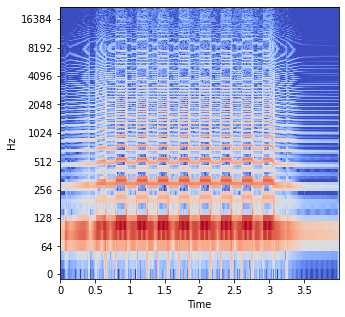

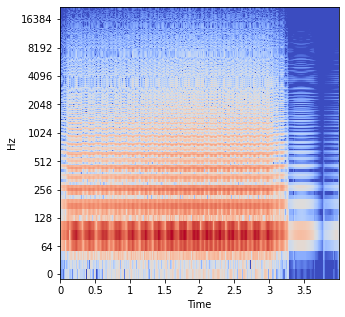

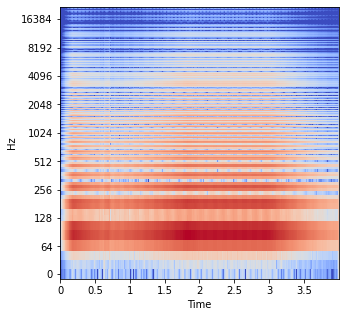

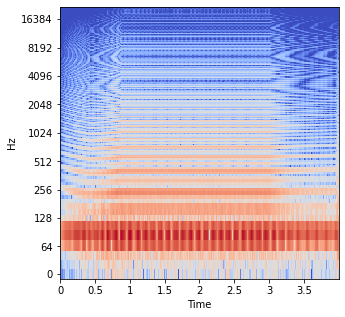

In [50]:
voice.unfreeze_all_parameters()
voice.set_parameters(
    {
        ("keyboard", "midi_f0"): tensor([42.0] * voice.batch_size),
        ("keyboard", "duration"): tensor([3.0] * voice.batch_size),
        ("vco_1", "tuning"): tensor([0.0] * voice.batch_size),
        ("vco_2", "tuning"): tensor([0.0] * voice.batch_size),
    },
    freeze=True,
)

voice_out, _, _ = voice()
for i in range(synthconfig16.batch_size):
    stft_plot(voice_out[i].cpu().view(-1).detach().numpy())
    ipd.display(
        ipd.Audio(voice_out[i].cpu().detach().numpy(), rate=voice.sample_rate.item())
    )

In [ ]:
from random import triangular


voice2 = Voice(synthconfig=synthconfig1).to(device)
voice2.set_parameters(
    {
        ("keyboard", "midi_f0"): tensor([40.0]),
        ("keyboard", "duration"): tensor([3.0]),
        ("vco_1", "tuning"): tensor([19.0]),
        # ("vco_1", "frequency"): tensor([todo]),

        ("vco_1", "mod_depth"): tensor([24.0]),
        ("vco_2", "tuning"): tensor([0.0]),
        ("vco_2", "mod_depth"): tensor([12.0]),
        ("vco_2", "shape"): tensor([1.0]),
    }
)


LFO1 - TRI
LFO2 - SINE
OSC1 - SQR
OSC2 - SQR

FILTER (LPF 24DB) - CUTOFF RESO ADSR
CHORUS
DELAY
REVERB

CREATE A CLASS THAT CREATES VARIOUS VOICES

EACH VOICE WILL HAVE A SET OF PRESET PARAMETERS FOR A GIVEN TARGET SOUND
THE VOICE CAN BE RE-USED BY CHANGING THE MIDI_F0 

THESE VOICES WILL BE SUMMED UP USING AN INSTANCE OF AUDIOMIXER

In [ ]:
from torchsynth.module import AudioMixer

synthconfig1 = SynthConfig(
    batch_size=1, reproducible=False, sample_rate=44100, buffer_size_seconds=4.0
)

env = torch.zeros((synthconfig1.batch_size, synthconfig1.buffer_size), device=device)

keyboard = MonophonicKeyboard(synthconfig, device=device)
sine = SineVCO(synthconfig, device=device)
square_saw = SquareSawVCO(synthconfig, device=device)
noise = Noise(synthconfig, seed=123, device=device)

midi_f0, note_on_duration = keyboard()
sine_out = sine(midi_f0, env)
sqr_out = square_saw(midi_f0, env)
noise_out = noise()

mixer = AudioMixer(synthconfig, 3, curves=[1.0, 1.0, 0.25]).to(device)
output = mixer(sine_out, sqr_out, noise_out)

ipd.Audio(output[0].cpu().detach().numpy(), rate=mixer.sample_rate.item(), normalize=False)

In [78]:
def generate_bgm(valence, arousal, total_duration, splits=[]):
    """
    Generates a background music based on the valence and arousal values.
    """
    sr=44100
    # Run generation on GPU if available
    if torch.cuda.is_available():
        device = "cuda"
    else:
        device = "cpu"
    synthconfig = SynthConfig(batch_size=1, reproducible=False, sample_rate=sr, buffer_size_seconds=total_duration)

    env = torch.zeros((synthconfig.batch_size, synthconfig.buffer_size), device=device)
    keyboard = MonophonicKeyboard(synthconfig, device=device)
    sine = SineVCO(synthconfig, device=device)
    square_saw = SquareSawVCO(synthconfig, device=device)
    noise = Noise(synthconfig, seed=123, device=device)

    midi_f0, note_on_duration = keyboard()
    sine_out = sine(midi_f0, env)
    sqr_out = square_saw(midi_f0, env)
    noise_out = noise()

    mixer = AudioMixer(synthconfig, 3, curves=[1.0, 1.0, 0.25]).to(device)
    output = mixer(sine_out, sqr_out, noise_out)
    return output[0].cpu().detach().numpy(), sr

In [79]:
generate_bgm(1,1,5)

(array([ 0.09148893,  0.09372362,  0.09591021, ..., -0.16725126,
        -0.16742142, -0.16761166], dtype=float32),
 44100)

In [81]:
aud,sr = generate_bgm(1,1,5)
ipd.Audio(aud, rate=sr, normalize=False)

/Users/vedant/miniconda3/envs/bgm-generation/lib/python3.10/site-packages/pytorch_lightning/core/lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


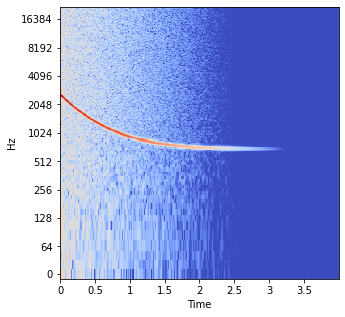

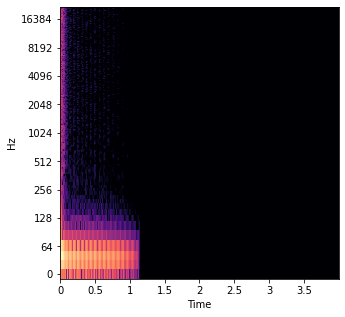

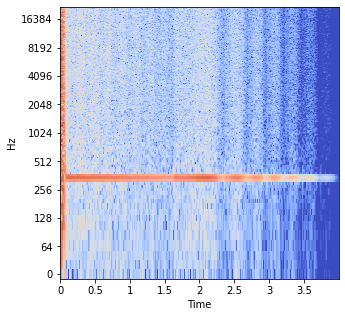

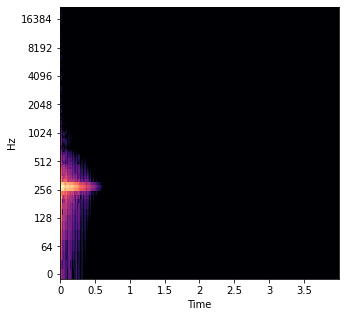

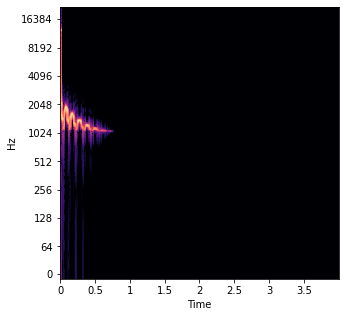

...

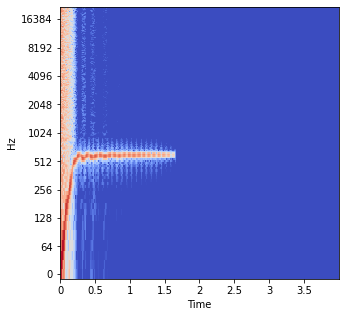

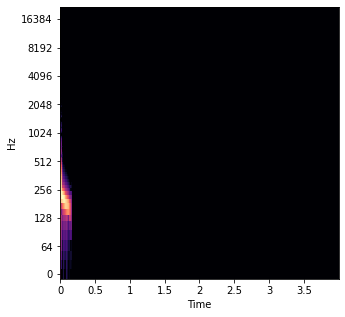

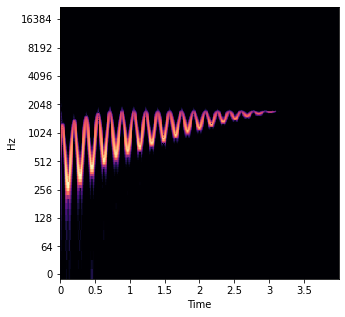

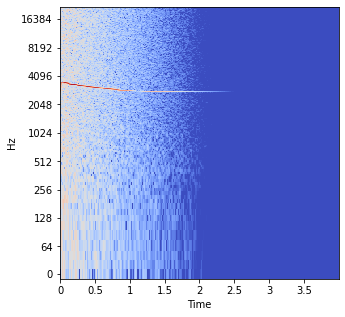

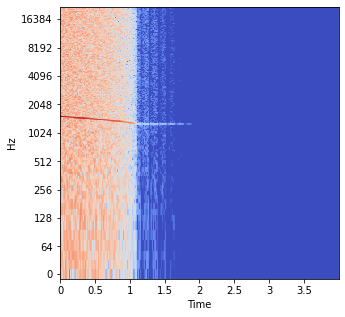

In [82]:

synthconfig16 = SynthConfig(
    batch_size=16, reproducible=False, sample_rate=44100, buffer_size_seconds=4
)
voice = Voice(synthconfig=synthconfig16, nebula="drum").to(device)
voice_out, _, _ = voice()
for i in range(synthconfig16.batch_size):
    stft_plot(voice_out[i].cpu().view(-1).detach().numpy())
    ipd.display(
        ipd.Audio(voice_out[i].cpu().detach().numpy(), rate=voice.sample_rate.item())
    )

![](../Tellegen-Watson-Clark-model-In-the-model-high-positive-affect-and-high-negative-affect.jpg)


In [98]:
# Parameter values for each octant
neutral={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

high_negative_affect={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

strong_engagement={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

high_positive_affect={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

pleasantness={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

low_negative_affect={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

disengagement={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

low_positive_affect={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

unpleasantness={
    "adsr_1":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "adsr_2":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo_1": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo_2": {
        "sin":0.0, # sine wave
        "tri":0.0, # triangle wave
        "saw":0.0, # sawtooth wave
        "rsaw":0.0, # reverse sawtooth wave
        "sqr":0.0, # square wave
    },
    "lfo1_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_amp_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo1_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
    "lfo2_rate_adsr":{
        "attack": 0.1, # attack time (sec) Range: 0.0 to 2.0
        "decay": 0.1,  # decay time (sec) Range: 0.0 to 2.0
        "sustain": 0.1,# sustain amplitude Range: 0.0 to 1.0
        "release": 0.1,# release time (sec) Range: 0.0 to 5.0
        "alpha":1, # attack curve Range: 0.0 to 6.0  (1 = linear, >1 = exponential)
    },
}

# Dict containing mappings of tuning, mod depth, and shape for VCO1 and VCO2 for each mood
mood_map = {
    "neutral":neutral,
    "high_negative_affect":high_negative_affect,
    "strong_engagement":strong_engagement,
    "high_positive_affect":high_positive_affect,
    "pleasantness":pleasantness,
    "low_negative_affect":low_negative_affect,
    "disengagement":disengagement,
    "low_positive_affect":low_positive_affect,
    "unpleasantness":unpleasantness,
}

In [105]:
print(mood_map['neutral'])
print("------------------------------")
print(mood_map['neutral']['adsr_1'])
print("------------------------------")
print(mood_map['neutral']['adsr_1']['attack'])

{'adsr_1': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}, 'adsr_2': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}, 'lfo_1': {'sin': 0.0, 'tri': 0.0, 'saw': 0.0, 'rsaw': 0.0, 'sqr': 0.0}, 'lfo_2': {'sin': 0.0, 'tri': 0.0, 'saw': 0.0, 'rsaw': 0.0, 'sqr': 0.0}, 'lfo1_amp_adsr': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}, 'lfo2_amp_adsr': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}, 'lfo1_rate_adsr': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}, 'lfo2_rate_adsr': {'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}}
------------------------------
{'attack': 0.1, 'decay': 0.1, 'sustain': 0.1, 'release': 0.1, 'alpha': 1}
------------------------------
0.1


In [17]:
from typing import Optional
import torch
from torchsynth.module import AudioMixer
from torchsynth.synth import AbstractSynth
from torchsynth.config import SynthConfig
from torchsynth.synth import Voice

import numpy as np
import librosa
import random
import numpy.random
import torch
from torch import tensor
import matplotlib.pyplot as plt

from torchsynth.parameter import ModuleParameterRange

# Determenistic seeds for replicable testing
random.seed(0)
numpy.random.seed(0)
torch.manual_seed(0)

# from torchsynth.module import (
#     ADSR,
#     ControlRateUpsample,
#     MonophonicKeyboard,
#     SquareSawVCO,
#     VCA,
# )
# Run examples on GPU if available
if torch.cuda.is_available():
    device = "cuda"
else:
    device = "cpu"


class CustomSynth():#AbstractSynth):
    def __init__(self, midi_f0, duration_in_seconds, sr, mood, device, n_high_voices, n_low_voices):
        
        self.midi_f0 = midi_f0
        self.duration_in_seconds = duration_in_seconds
        self.sample_rate = sr
        self.mood = mood
        self.device = device
        self.n_high_voices = n_high_voices
        self.n_low_voices = n_low_voices
        self.total_n_voices = self.n_low_voices + self.n_high_voices #+ 1
        self.mix_levels = [1,1] # TODO: Add mix level lookup for each mood
        # print(len(self.mix_levels))
        self.synthconfig = SynthConfig(batch_size=1, reproducible=False, sample_rate=self.sample_rate, buffer_size_seconds=self.duration_in_seconds)

        self.mixer = AudioMixer(synthconfig, self.total_n_voices, curves=self.mix_levels).to(device)
        
        # Call the constructor in the parent AbstractSynth class
        #super().__init__(synthconfig=self.synthconfig)

        # Instantiating the low voices
        self.low_voices={}
        for n in range(n_low_voices):
            self.low_voices[n] = Voice(synthconfig=self.synthconfig).to(self.device)
            
            # set tuning parameter based on number of voices
            self.low_voices[n].set_parameters(
                                    {
                                        ("keyboard", "midi_f0"): tensor([self.midi_f0]),
                                        ("keyboard", "duration"): tensor([self.duration_in_seconds]),
                                        ("vco_1", "tuning"): tensor([19.0]), #TODO: Change this to select from the mood dicts
                                        ("vco_1", "mod_depth"): tensor([24.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "tuning"): tensor([0.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "mod_depth"): tensor([12.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "shape"): tensor([1.0]),#TODO: Change this to select from the mood dicts
                                    }
                                )

        # Instantiating the high voices
        self.high_voices={}
        for n in range(self.n_high_voices):
            self.high_voices[n] = Voice(synthconfig=self.synthconfig).to(self.device)

            # set tuning parameter based on number of voices
            self.low_voices[n].set_parameters(
                                    {
                                        ("keyboard", "midi_f0"): tensor([self.midi_f0]),
                                        ("keyboard", "duration"): tensor([self.duration_in_seconds]),
                                        ("vco_1", "tuning"): tensor([19.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_1", "mod_depth"): tensor([24.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "tuning"): tensor([0.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "mod_depth"): tensor([12.0]),#TODO: Change this to select from the mood dicts
                                        ("vco_2", "shape"): tensor([1.0]),#TODO: Change this to select from the mood dicts
                                    }
                                )
    def generate_audio():
        


In [11]:
synthconfig = SynthConfig(batch_size=1, reproducible=False, sample_rate=44100, buffer_size_seconds=4)
v=Voice(synthconfig=synthconfig).to(device)

/Users/vedant/miniconda3/envs/bgm-generation/lib/python3.10/site-packages/pytorch_lightning/core/lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


In [3]:
v.set_parameters({("lfo_2", "sin"): tensor([1])})

In [4]:
v.get_parameters()

OrderedDict([(('adsr_1', 'attack'),
              ModuleParameter(name=attack, value=tensor([0.0885]))),
             (('adsr_1', 'decay'),
              ModuleParameter(name=decay, value=tensor([0.1320]))),
             (('adsr_1', 'sustain'),
              ModuleParameter(name=sustain, value=tensor([0.3074]))),
             (('adsr_1', 'release'),
              ModuleParameter(name=release, value=tensor([0.6341]))),
             (('adsr_1', 'alpha'),
              ModuleParameter(name=alpha, value=tensor([0.4901]))),
             (('adsr_2', 'attack'),
              ModuleParameter(name=attack, value=tensor([0.8964]))),
             (('adsr_2', 'decay'),
              ModuleParameter(name=decay, value=tensor([0.4556]))),
             (('adsr_2', 'sustain'),
              ModuleParameter(name=sustain, value=tensor([0.6323]))),
             (('adsr_2', 'release'),
              ModuleParameter(name=release, value=tensor([0.3489]))),
             (('adsr_2', 'alpha'),
              Modu

In [16]:
synth = CustomSynth(42,4,44100,"neutral",device,1,1)

2


/Users/vedant/miniconda3/envs/bgm-generation/lib/python3.10/site-packages/pytorch_lightning/core/lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


In [24]:
midi_f0 = 420#midi_f0
duration_in_seconds = 4#duration_in_seconds
sample_rate = 44100#sr
# mood = mood
device = device
n_high_voices = 1#n_high_voices
n_low_voices = 1#n_low_voices
total_n_voices = n_low_voices + n_high_voices #+ 1
mix_levels = [1,1] # TODO: Add mix level lookup for each mood
# print(len(self.mix_levels))
synthconfig = SynthConfig(batch_size=1, reproducible=False, sample_rate=sample_rate, buffer_size_seconds=duration_in_seconds)

mixer = AudioMixer(synthconfig, total_n_voices, curves=mix_levels).to(device)

# Call the constructor in the parent AbstractSynth class
#super().__init__(synthconfig=self.synthconfig)

# Instantiating the low voices
low_voices={}
for n in range(n_low_voices):
    low_voices[n] = Voice(synthconfig=synthconfig).to(device)
    
    # set tuning parameter based on number of voices
    low_voices[n].set_parameters(
                            {
                                ("keyboard", "midi_f0"): tensor([midi_f0]),
                                ("keyboard", "duration"): tensor([duration_in_seconds]),
                                ("vco_1", "tuning"): tensor([19.0]), #TODO: Change this to select from the mood dicts
                                ("vco_1", "mod_depth"): tensor([24.0]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "tuning"): tensor([0.0]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "mod_depth"): tensor([12.0]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "shape"): tensor([1.0]),#TODO: Change this to select from the mood dicts
                            }
                        )

# Instantiating the high voices
high_voices={}
for n in range(n_high_voices):
    high_voices[n] = Voice(synthconfig=synthconfig).to(device)

    # set tuning parameter based on number of voices
    low_voices[n].set_parameters(
                            {
                                ("keyboard", "midi_f0"): tensor([midi_f0]),
                                ("keyboard", "duration"): tensor([duration_in_seconds]),
                                ("vco_1", "tuning"): tensor([0.1]),#TODO: Change this to select from the mood dicts
                                ("vco_1", "mod_depth"): tensor([0.24]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "tuning"): tensor([0.0]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "mod_depth"): tensor([0.12]),#TODO: Change this to select from the mood dicts
                                ("vco_2", "shape"): tensor([1.0]),#TODO: Change this to select from the mood dicts
                            }
                        )

/Users/vedant/miniconda3/envs/bgm-generation/lib/python3.10/site-packages/pytorch_lightning/core/lightning.py:22: LightningDeprecationWarning: pytorch_lightning.core.lightning.LightningModule has been deprecated in v1.7 and will be removed in v1.9. Use the equivalent class from the pytorch_lightning.core.module.LightningModule class instead.
  rank_zero_deprecation(


AssertionError: 